# Assignment 2a: Traffic Sign Object Detection
**Student:** Damian Cutajar
**Goal:** Train Faster R-CNN to detect 6 traffic sign classes.

IMPORTING NECESSARY LIBRARIES

In [13]:
# Imports and Setup
import os
import json
import torch
import torch.utils.data
import torchvision
from PIL import Image, ImageOps
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision import transforms as T
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import time
import pandas as pd
import numpy as np
from collections import Counter
import seaborn as sns
from sklearn.metrics import confusion_matrix
from torchvision.ops import box_iou
from torchmetrics.detection.mean_ap import MeanAveragePrecision

VERIFYING THE CUDA INSTALLATION AND GPU

In [3]:
print(torch.__version__)
print(torch.version.cuda)
print(torch.cuda.get_device_name())
print(torch.cuda.get_device_capability())
# Check device
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
print(f"Using device: {device}")

2.11.0.dev20260113+cu128
12.8
NVIDIA GeForce RTX 5070 Ti
(12, 0)
Using device: cuda


DEFINING DATASET CLASS

In [4]:
# Define Custom Dataset Class
class TrafficSignDataset(torch.utils.data.Dataset):
    def __init__(self, root, annotation_file, transforms=None):
        self.root = root
        self.transforms = transforms
        
        # Load COCO JSON
        with open(annotation_file, 'r') as f:
            self.coco = json.load(f)
            
        # Create a map of image_id -> image_info
        self.images = {img['id']: img for img in self.coco['images']}
        self.img_ids = list(self.images.keys())
        
        # Create a map of image_id -> list of annotations
        self.coco_anns = {img_id: [] for img_id in self.img_ids}
        for ann in self.coco['annotations']:
            self.coco_anns[ann['image_id']].append(ann)

        # Mapping classes
        # 0=BG, 1=Stop, 2=No Entry, 3=Pedestrian, 4=Roundabout, 5=No Through, 6=Blind Spot
        self.cat_map = {
            1: 1, 2: 2, 3: 3, 4: 4, 5: 5, 6: 6
        }

    def __getitem__(self, idx):
        img_id = self.img_ids[idx]
        img_info = self.images[img_id]
        
        # Load Image
        img_path = os.path.join(self.root, img_info['file_name'])
        img = Image.open(img_path).convert("RGB")
        
        # Fix Rotation
        img = ImageOps.exif_transpose(img)

        # Get Annotations
        anns = self.coco_anns[img_id]
        boxes = []
        labels = []
        
        for ann in anns:
            x, y, w, h = ann['bbox']
            boxes.append([x, y, x + w, y + h])
            labels.append(self.cat_map.get(ann['category_id'], 0))

        boxes = torch.as_tensor(boxes, dtype=torch.float32)
        labels = torch.as_tensor(labels, dtype=torch.int64)
        image_id = torch.tensor([idx])
        area = (boxes[:, 3] - boxes[:, 1]) * (boxes[:, 2] - boxes[:, 0])
        iscrowd = torch.zeros((len(labels),), dtype=torch.int64)

        target = {}
        target["boxes"] = boxes
        target["labels"] = labels
        target["image_id"] = image_id
        target["area"] = area
        target["iscrowd"] = iscrowd

        if self.transforms:
            img = self.transforms(img)

        return img, target

    def __len__(self):
        return len(self.img_ids)

# Define simple transform
def get_transform():
    return T.Compose([T.ToTensor()])


In [5]:
# Model Definition
def get_model_instance_segmentation(num_classes):
    # Load pre-trained Faster R-CNN (ResNet-50)
    model = torchvision.models.detection.fasterrcnn_resnet50_fpn(weights="DEFAULT")
    
    # Get number of input features for the classifier
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    
    # Replace the pre-trained head with a new one for our num_classes
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)
    
    return model

DEFINING DATASET FOLDERS

In [6]:
# Initialize Data and Model
# PATH CONFIGURATION
data_dir = r"C:\GitHub\Advanced-CV---Group-Assignment\ARI3129 - Assignment Materials\reissueswithmembermerger_ipynb\COCO-based_COCO\images\train"
json_file = r"C:\GitHub\Advanced-CV---Group-Assignment\ARI3129 - Assignment Materials\reissueswithmembermerger_ipynb\COCO-based_COCO\annotations\train.json"

data_val_dir = r"C:\GitHub\Advanced-CV---Group-Assignment\ARI3129 - Assignment Materials\reissueswithmembermerger_ipynb\COCO-based_COCO\images\val"
json_val_file = r"C:\GitHub\Advanced-CV---Group-Assignment\ARI3129 - Assignment Materials\reissueswithmembermerger_ipynb\COCO-based_COCO\annotations\val.json"

data_test_dir = r"C:\GitHub\Advanced-CV---Group-Assignment\ARI3129 - Assignment Materials\reissueswithmembermerger_ipynb\COCO-based_COCO\images\test"
json_test_file = r"C:\GitHub\Advanced-CV---Group-Assignment\ARI3129 - Assignment Materials\reissueswithmembermerger_ipynb\COCO-based_COCO\annotations\test.json"

dataset = TrafficSignDataset(data_dir, json_file, get_transform())
dataset_val = TrafficSignDataset(data_val_dir, json_val_file, get_transform())
dataset_test = TrafficSignDataset(data_test_dir, json_test_file, get_transform())

TRAINING SCRIPT

In [7]:
OUTPUT_DIR = os.path.join("Outputs", "Damian", "Sign_Detector","Run2")
os.makedirs(OUTPUT_DIR, exist_ok=True)
print(f"📂 Saving all results to: {os.path.abspath(OUTPUT_DIR)}")

📂 Saving all results to: c:\GitHub\CV2\Advanced-CV---Group-Assignment\Scripts\Outputs\Damian\Sign_Detector\Run2


🚀 Starting Training on: cuda
✅ POWER UNLOCKED: Training on NVIDIA GeForce RTX 5070 Ti
Dataset Size -> Train: 604 | Val: 133

STARTING TRAINING FOR 10 EPOCHS

--- Epoch 1/10 ---
  [Batch 50] Train Loss: 0.2827
  [Batch 100] Train Loss: 0.2977
✅ Train Loss: 0.3532
  Running Validation... Done. Val Loss: 0.2740
💾 Checkpoint saved: run1_model_epoch_1.pth

--- Epoch 2/10 ---
  [Batch 50] Train Loss: 0.3671
  [Batch 100] Train Loss: 0.1119
✅ Train Loss: 0.2048
  Running Validation... Done. Val Loss: 0.1941
💾 Checkpoint saved: run1_model_epoch_2.pth

--- Epoch 3/10 ---
  [Batch 50] Train Loss: 0.1053
  [Batch 100] Train Loss: 0.0965
✅ Train Loss: 0.1389
  Running Validation... Done. Val Loss: 0.1629
💾 Checkpoint saved: run1_model_epoch_3.pth

--- Epoch 4/10 ---
  [Batch 50] Train Loss: 0.1107
  [Batch 100] Train Loss: 0.1655
✅ Train Loss: 0.1071
  Running Validation... Done. Val Loss: 0.1443
💾 Checkpoint saved: run1_model_epoch_4.pth

--- Epoch 5/10 ---
  [Batch 50] Train Loss: 0.0640
  [Batc

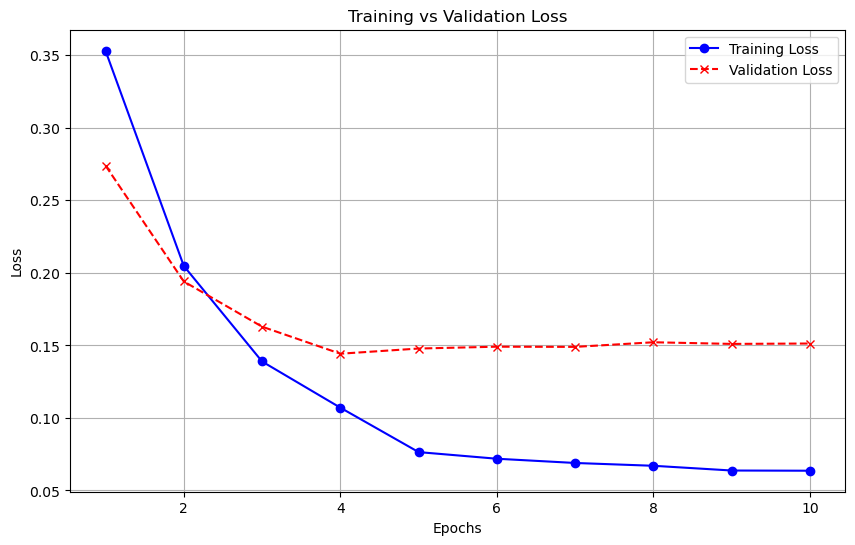

✅ Results saved in: Outputs\Damian\Sign_Detector\Run2


In [7]:
### TRAINING SCRIPT
# CRASH PREVENTION & HARDWARE SETUP
os.environ["KMP_DUPLICATE_LIB_OK"] = "TRUE"
print(f"🚀 Starting Training on: {device}")

if torch.cuda.is_available():
    device = torch.device('cuda')
    gpu_name = torch.cuda.get_device_name(0)
    print(f"✅ POWER UNLOCKED: Training on {gpu_name}")
else:
    raise RuntimeError("❌ CUDA not found! Please check your PyTorch installation again.")

# DATA LOADERS
print(f"Dataset Size -> Train: {len(dataset)} | Val: {len(dataset_val)}")
BATCH_SIZE = 6

data_loader_train = torch.utils.data.DataLoader(
    dataset, batch_size=BATCH_SIZE, shuffle=True, collate_fn=lambda x: tuple(zip(*x))
)

data_loader_val = torch.utils.data.DataLoader(
    dataset_val, batch_size=BATCH_SIZE, shuffle=False, collate_fn=lambda x: tuple(zip(*x))
)

# MODEL SETUP
def get_model(num_classes):
    model = torchvision.models.detection.fasterrcnn_resnet50_fpn(
        weights="DEFAULT" 
    )
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)
    return model

# 7 Classes: Background + 6 Signs
model = get_model(num_classes=7)
model.to(device)

# OPTIMISER & SCHEDULER
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=0.005, momentum=0.9, weight_decay=0.0005)

# Reduce Learning Rate by 10x every 4 epochs
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=4, gamma=0.1)

# LOGGING CONFIGURATION
num_epochs = 10
csv_path = os.path.join(OUTPUT_DIR, "training_log.csv")
history = {'epoch': [], 'train_loss': [], 'val_loss': []}
csv_file = "training_log.csv"

print(f"\nSTARTING TRAINING FOR {num_epochs} EPOCHS")
print("="*60)
start_time = time.time()

# MAIN TRAINING LOOP
for epoch in range(num_epochs):
    print(f"\n--- Epoch {epoch+1}/{num_epochs} ---")
    
    model.train()
    train_loss_sum = 0
    steps = 0
    
    for imgs, annotations in data_loader_train:
        steps += 1
        
        # Load data to device
        imgs = list(img.to(device) for img in imgs)
        annotations = [{k: v.to(device) for k, v in t.items()} for t in annotations]
        
        # Calculate Loss
        loss_dict = model(imgs, annotations)
        losses = sum(loss for loss in loss_dict.values())

        # Backpropagation
        optimizer.zero_grad()
        losses.backward()
        optimizer.step()
        
        train_loss_sum += losses.item()
        
        # Print update every 50 batches
        if steps % 50 == 0:
            print(f"  [Batch {steps}] Train Loss: {losses.item():.4f}")

    avg_train_loss = train_loss_sum / steps
    print(f"✅ Train Loss: {avg_train_loss:.4f}")

    # We keep the model in train() mode to compute the loss, but we wrap it in no_grad() so it doesn't learn from this data.
    print("  Running Validation...", end="")
    val_loss_sum = 0
    val_steps = 0
    
    with torch.no_grad():
        for imgs, annotations in data_loader_val:
            val_steps += 1
            imgs = list(img.to(device) for img in imgs)
            annotations = [{k: v.to(device) for k, v in t.items()} for t in annotations]
            
            loss_dict = model(imgs, annotations)
            losses = sum(loss for loss in loss_dict.values())
            val_loss_sum += losses.item()
            
    avg_val_loss = val_loss_sum / val_steps
    print(f" Done. Val Loss: {avg_val_loss:.4f}")
    # --- LOGGING & CHECKPOINTING ---
    # Update History Dictionary
    history['epoch'].append(epoch + 1)
    history['train_loss'].append(avg_train_loss)
    history['val_loss'].append(avg_val_loss)
    
    # Save to CSV (Backup)
    pd.DataFrame(history).to_csv(csv_path, index=False)
    
    # Save Model Checkpoint
    save_name = f"run1_model_epoch_{epoch+1}.pth"
    save_path = os.path.join(OUTPUT_DIR, save_name)
    torch.save(model.state_dict(), save_path)
    print(f"💾 Checkpoint saved: {save_name}")
    
    # 4. Step the Scheduler
    lr_scheduler.step()

# --- 7. FINAL RESULTS & PLOTTING ---
total_time = time.time() - start_time
print("="*60)
print(f"🎉 TRAINING COMPLETE in {total_time/3600:.2f} hours.")

# Generate Graph
plt.figure(figsize=(10, 6))
plt.plot(history['epoch'], history['train_loss'], label='Training Loss', marker='o', color='blue')
plt.plot(history['epoch'], history['val_loss'], label='Validation Loss', marker='x', linestyle='--', color='red')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training vs Validation Loss')
plt.legend()
plt.grid(True)
graph_path = os.path.join(OUTPUT_DIR, "run1_training_loss_graph.png")
plt.savefig(graph_path)
plt.show()

print(f"✅ Results saved in: {OUTPUT_DIR}")

VISUALISING TRAINED MODEL ON TEST DATASET

In [8]:
OUTPUT_DIR = os.path.join("Outputs", "Damian", "Sign_Detector","Run1")

In [9]:
# SETTINGS & STYLING
CONFIDENCE_THRESHOLD = 0.7

# Model Path CHANGE TO BEST MODEL AFTER ANALYSING DATA ABOVE
best_save_name = "run1_model_epoch_30.pth"

save_path = os.path.join(OUTPUT_DIR, best_save_name)
MODEL_PATH = save_path
os.environ["KMP_DUPLICATE_LIB_OK"] = "TRUE"

# Professional Color Palette
COLOR_BOX = '#00FF00'     # Lime Green for detection
COLOR_TEXT_BG = (0, 0, 0, 0.6) # Semi-transparent black
COLOR_BORDER_HIT = '#00CC00'   # Green border if sign found
COLOR_BORDER_MISS = '#FF3333'  # Red border if no sign found

# Class Map
class_map = {
    0: "Background",
    1: "Blind-Spot Mirror",
    2: "No Entry",
    3: "No Through Road",
    4: "Pedestrian Crossing",
    5: "Roundabout Ahead",
    6: "Stop"
}

# SETUP & MODEL
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
print(f"✅ EVALUATION DEVICE: {torch.cuda.get_device_name(0)}")

def get_model(num_classes):
    model = torchvision.models.detection.fasterrcnn_resnet50_fpn(weights=None)
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)
    return model

# Load Model
model = get_model(num_classes=7)
if os.path.exists(MODEL_PATH):
    model.load_state_dict(torch.load(MODEL_PATH, map_location=device))
    model.to(device)
    model.eval()
    print(f"✅ Model Loaded: {MODEL_PATH}")
else:
    raise FileNotFoundError(f"❌ Model file '{MODEL_PATH}' not found!")

# PREPARE DATA
if 'dataset_test' not in globals():
    print("⚠️ 'dataset_test' missing. Using 'dataset_val' as fallback.")
    target_dataset = dataset_val if 'dataset_val' in globals() else dataset
else:
    target_dataset = dataset_test


✅ EVALUATION DEVICE: NVIDIA GeForce RTX 5070 Ti
✅ Model Loaded: Outputs\Damian\Sign_Detector\Run1\run1_model_epoch_30.pth


Processing 138 images using Per-Class Thresholds...
Rendering image grid...


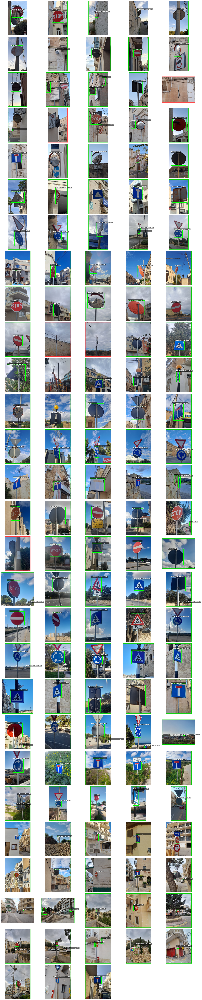


--- Detection Stats ---
Ground Truths: 175
Predictions:   172


In [16]:
# CONFIGURATION
PER_CLASS_THRESHOLDS = {
    1: 0.70,  # Blind Spot
    2: 0.84,  # No Entry
    3: 0.55,  # No Through
    4: 0.85,  # Pedestrian
    5: 0.90,  # Roundabout
    6: 0.60   # Stop
}

# INFERENCE LOOP
gt_counts = Counter()
pred_counts = Counter()
results_buffer = []

print(f"Processing {len(target_dataset)} images using Per-Class Thresholds...")

with torch.no_grad():
    for i in range(len(target_dataset)):
        img_tensor, target = target_dataset[i]
        
        # Record Ground Truth
        for lbl in target['labels']:
            gt_counts[class_map.get(lbl.item(), "Unknown")] += 1
            
        # Run Prediction
        prediction = model([img_tensor.to(device)])[0]
        
        # Filter Predictions
        pred_boxes = prediction['boxes']
        pred_scores = prediction['scores']
        pred_labels = prediction['labels']
        
        keep_indices = []
        for idx, (score, label) in enumerate(zip(pred_scores, pred_labels)):
            lbl_val = label.item()
            # Get the specific threshold for this class ID
            thresh = PER_CLASS_THRESHOLDS.get(lbl_val, 0.5)
            
            if score >= thresh:
                keep_indices.append(idx)
        
        # Handle Empty vs Non-Empty detections
        if len(keep_indices) > 0:
            # Keep specific indices
            final_boxes = pred_boxes[keep_indices].cpu().numpy()
            final_labels = pred_labels[keep_indices].cpu().numpy()
            final_scores = pred_scores[keep_indices].cpu().numpy()
            found_any = True
        else:
            final_boxes = np.array([])
            final_labels = np.array([])
            final_scores = np.array([])
            found_any = False
        
        # Record Filtered Predictions
        for lbl in final_labels:
            pred_counts[class_map.get(lbl, "Unknown")] += 1
            
        # Save for Visualisation
        img_np = img_tensor.mul(255).permute(1, 2, 0).byte().cpu().numpy()
        results_buffer.append({
            'img': img_np,
            'boxes': final_boxes,
            'labels': final_labels,
            'scores': final_scores,
            'found': found_any
        })

# VISUALISATION
cols = 5
rows = int(np.ceil(len(target_dataset) / cols))
fig_height = rows * 3.5

fig, axes = plt.subplots(rows, cols, figsize=(20, fig_height))
axes = axes.ravel()

print("Rendering image grid...")

for i, ax in enumerate(axes):
    if i >= len(results_buffer):
        ax.axis('off')
        continue
        
    res = results_buffer[i]
    ax.imshow(res['img'])
    ax.set_xticks([])
    ax.set_yticks([])
    
    # Border Logic
    border_color = COLOR_BORDER_HIT if res['found'] else COLOR_BORDER_MISS
    for spine in ax.spines.values():
        spine.set_edgecolor(border_color)
        spine.set_linewidth(2)

    # Draw Boxes
    for j, box in enumerate(res['boxes']):
        x1, y1, x2, y2 = box
        label_name = class_map.get(res['labels'][j], "Unknown")
        score = res['scores'][j]
        
        # Box
        rect = patches.Rectangle((x1, y1), x2-x1, y2-y1, 
                                 linewidth=1.5, edgecolor=COLOR_BOX, facecolor='none')
        ax.add_patch(rect)
        
        # Text Label
        ax.text(x1, y1, f"{label_name} {score:.0%}", 
                color='white', fontsize=8, weight='bold',
                bbox=dict(facecolor=COLOR_TEXT_BG, edgecolor='none', pad=2))

plt.tight_layout()
plt.show()

print("\n--- Detection Stats ---")
print(f"Ground Truths: {sum(gt_counts.values())}")
print(f"Predictions:   {sum(pred_counts.values())}")

Predicitions Counter


📈 Generating Class Distribution Analysis...


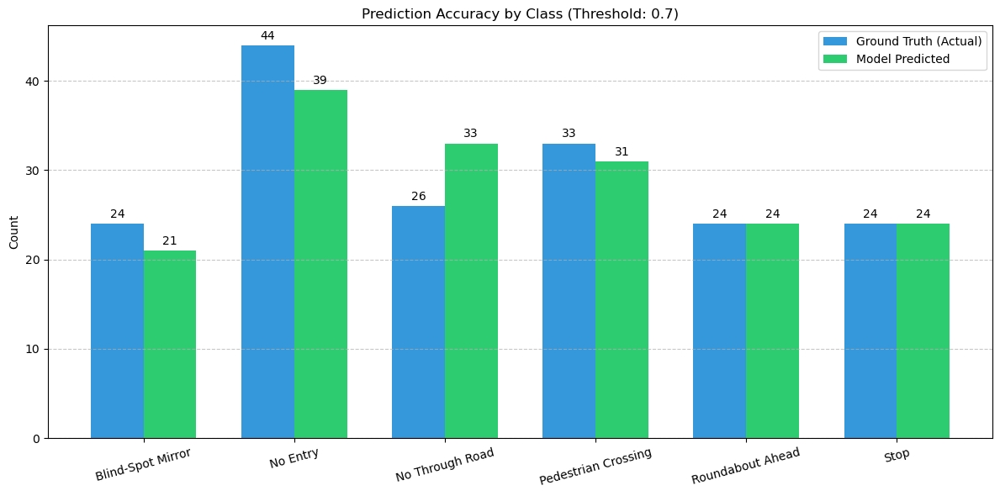

In [17]:
# ANALYSIS: GROUND TRUTH VS PREDICTIONS GRAPH 
print("\n📈 Generating Class Distribution Analysis...")

classes = [class_map[i] for i in range(1, 7)] # Classes 1-6
gt_values = [gt_counts[c] for c in classes]
pred_values = [pred_counts[c] for c in classes]

x = np.arange(len(classes))
width = 0.35

fig, ax = plt.subplots(figsize=(12, 6))
rects1 = ax.bar(x - width/2, gt_values, width, label='Ground Truth (Actual)', color='#3498db')
rects2 = ax.bar(x + width/2, pred_values, width, label='Model Predicted', color='#2ecc71')

ax.set_ylabel('Count')
ax.set_title(f'Prediction Accuracy by Class (Threshold: {CONFIDENCE_THRESHOLD})')
ax.set_xticks(x)
ax.set_xticklabels(classes, rotation=15)
ax.legend()
ax.grid(axis='y', linestyle='--', alpha=0.7)

# Add counts on top of bars
def autolabel(rects):
    for rect in rects:
        height = rect.get_height()
        ax.annotate(f'{height}',
                    xy=(rect.get_x() + rect.get_width() / 2, height),
                    xytext=(0, 3), textcoords="offset points",
                    ha='center', va='bottom')

autolabel(rects1)
autolabel(rects2)

plt.tight_layout()
plt.show()

Generating Confusion Matrix with Per-Class Thresholds...
   Settings: {1: 0.7, 2: 0.84, 3: 0.55, 4: 0.85, 5: 0.9, 6: 0.6}


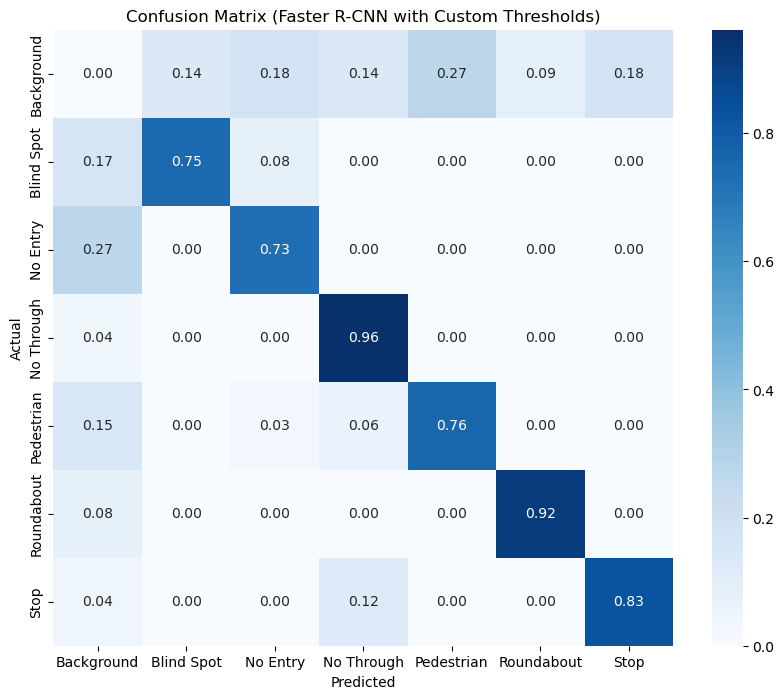


--- Raw Counts ---
            Background  Blind Spot  No Entry  No Through  Pedestrian  \
Background           0           3         4           3           6   
Blind Spot           4          18         2           0           0   
No Entry            12           0        32           0           0   
No Through           1           0         0          25           0   
Pedestrian           5           0         1           2          25   
Roundabout           2           0         0           0           0   
Stop                 1           0         0           3           0   

            Roundabout  Stop  
Background           2     4  
Blind Spot           0     0  
No Entry             0     0  
No Through           0     0  
Pedestrian           0     0  
Roundabout          22     0  
Stop                 0    20  


In [14]:
eval_dataset = dataset_test

data_loader_val = torch.utils.data.DataLoader(
    eval_dataset, 
    batch_size=6, 
    shuffle=False, 
    collate_fn=lambda x: tuple(zip(*x)))

PER_CLASS_THRESHOLDS = {
    1: 0.70,  # Blind Spot
    2: 0.84,  # No Entry
    3: 0.55,  # No Through
    4: 0.85,  # Pedestrian
    5: 0.90,  # Roundabout
    6: 0.60   # Stop
}

CLASS_NAMES = ["Background", "Blind Spot", "No Entry", "No Through", "Pedestrian", "Roundabout", "Stop", ]

def apply_thresholds(prediction, thresholds):
    keep_indices = []
    scores = prediction['scores']
    labels = prediction['labels']
    
    for i, (score, label) in enumerate(zip(scores, labels)):
        lbl_item = label.item()
        # Default to 0.5 if class not in dict
        thresh = thresholds.get(lbl_item, 0.5) 
        
        if score >= thresh:
            keep_indices.append(i)
            
    if not keep_indices:
        return {k: torch.tensor([]).to(prediction['boxes'].device) for k in prediction}
        
    keep_indices = torch.tensor(keep_indices, dtype=torch.long).to(scores.device)
    
    return {
        'boxes': prediction['boxes'][keep_indices],
        'labels': prediction['labels'][keep_indices],
        'scores': prediction['scores'][keep_indices]
    }

def generate_confusion_matrix(model, data_loader, device, thresholds):
    print("Generating Confusion Matrix with Per-Class Thresholds...")
    print(f"   Settings: {PER_CLASS_THRESHOLDS}")
    model.eval()
    
    y_true = []
    y_pred = []
    
    with torch.no_grad():
        for images, targets in data_loader:
            images = list(img.to(device) for img in images)
            
            # Get Raw Predictions
            outputs = model(images)
            
            for i, output in enumerate(outputs):
                target = targets[i]
                
                # 1. Filter Prediction by Per-Class Thresholds
                filtered_pred = apply_thresholds(output, thresholds)
                
                pred_boxes = filtered_pred['boxes'].cpu()
                pred_labels = filtered_pred['labels'].cpu()
                
                gt_boxes = target['boxes'].cpu()
                gt_labels = target['labels'].cpu()
                
                # If no GT boxes, all preds are False Positives (Background -> Class)
                if len(gt_boxes) == 0:
                    for p_label in pred_labels:
                        y_true.append(0) # Background
                        y_pred.append(p_label.item())
                    continue
                
                # If no Pred boxes, all GTs are False Negatives (Class -> Background)
                if len(pred_boxes) == 0:
                    for t_label in gt_labels:
                        y_true.append(t_label.item())
                        y_pred.append(0) # Background
                    continue
                    
                # 2. Match Predictions to GT using IoU
                ious = box_iou(gt_boxes, pred_boxes)
                
                # For each GT, find best matching Prediction
                # (Simple greedy matching: max IoU > 0.5)
                gt_matched = set()
                pred_matched = set()
                
                for t_idx, t_label in enumerate(gt_labels):
                    # Find max IoU for this GT
                    max_iou, p_idx = torch.max(ious[t_idx], dim=0)
                    
                    if max_iou > 0.5: # IoU Threshold for a valid match
                        p_idx = p_idx.item()
                        if p_idx not in pred_matched:
                            # We have a match (location wise)
                            # Check if classes match
                            y_true.append(t_label.item())
                            y_pred.append(pred_labels[p_idx].item())
                            
                            gt_matched.add(t_idx)
                            pred_matched.add(p_idx)
                        else:
                            # Already matched this prediction to another GT?
                            # Treat this GT as missed (FN)
                            y_true.append(t_label.item())
                            y_pred.append(0)
                    else:
                        # No overlap > 0.5 found
                        y_true.append(t_label.item())
                        y_pred.append(0) # Background (Missed)
                        
                # 3. Handle remaining Unmatched Predictions (False Positives)
                for p_idx, p_label in enumerate(pred_labels):
                    if p_idx not in pred_matched:
                        y_true.append(0) # Background
                        y_pred.append(p_label.item())

    return y_true, y_pred

# --- RUN ANALYSIS ---
# Use your Validation or Test Loader here
true_labels, pred_labels = generate_confusion_matrix(model, data_loader_val, device, PER_CLASS_THRESHOLDS)

# --- PLOT ---
cm = confusion_matrix(true_labels, pred_labels, labels=range(len(CLASS_NAMES)))

# Normalize
cm_norm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
cm_norm = np.nan_to_num(cm_norm) # Replace NaNs with 0 if division by zero

plt.figure(figsize=(10, 8))
sns.heatmap(cm_norm, annot=True, fmt='.2f', cmap='Blues', 
            xticklabels=CLASS_NAMES, yticklabels=CLASS_NAMES)
plt.title('Confusion Matrix (Faster R-CNN with Custom Thresholds)')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

print("\n--- Raw Counts ---")
df_cm = pd.DataFrame(cm, index=CLASS_NAMES, columns=CLASS_NAMES)
print(df_cm)

EVALUATION METRICS

In [14]:
def collate_fn(batch):
    return tuple(zip(*batch))

# Create the Data Loader for the Test Split
data_loader_test = torch.utils.data.DataLoader(
    dataset_test,
    batch_size=4,
    shuffle=False,          # Don't shuffle test data
    num_workers=0,
    collate_fn=collate_fn   # Essential for Object Detection!
)

print("✅ Data Loader Ready.")

✅ Data Loader Ready.


In [15]:
PER_CLASS_THRESHOLDS = {
    1: 0.70,  # Blind Spot
    2: 0.84,  # No Entry
    3: 0.55,  # No Through
    4: 0.85,  # Pedestrian
    5: 0.90,  # Roundabout
    6: 0.60   # Stop
}

def evaluate_model(model, loader, device, thresholds):
    print("🚀 Starting Evaluation...")
    
    # Initialise Metric
    map_metric = MeanAveragePrecision(box_format='xyxy', iou_type='bbox', class_metrics=True)
    
    model.eval()
    model.to(device)
    
    inference_times = []
    tp, fp, fn = 0, 0, 0
    
    with torch.no_grad():
        for i, (images, targets) in enumerate(loader):
            images = [img.to(device) for img in images]
            
            # MEASURE SPEED (Inference Time)
            start = time.time()
            outputs = model(images)
            end = time.time()
            inference_times.append((end - start) * 1000 / len(images)) # ms per image
            
            # Move to CPU for calculations
            preds = [{k: v.cpu() for k, v in p.items()} for p in outputs]
            targets = [{k: v.cpu() for k, v in t.items()} for t in targets]
            
            # Update mAP Metric (Standard COCO way)
            map_metric.update(preds, targets)
            
            # CALCULATE F1/PRECISION/RECALL
            for p, t in zip(preds, targets):
                gt_boxes = t['boxes']
                gt_labels = t['labels']
                
                # 1. Filter Predictions by Threshold
                keep_indices = []
                for idx, score in enumerate(p['scores']):
                    label = p['labels'][idx].item()
                    thresh = thresholds.get(label, 0.5) # Default to 0.5 if missing
                    if score >= thresh:
                        keep_indices.append(idx)
                
                if not keep_indices:
                    p_boxes = torch.empty((0, 4))
                    p_labels = torch.empty((0,), dtype=torch.int64)
                else:
                    keep_idx = torch.tensor(keep_indices, dtype=torch.long)
                    p_boxes = p['boxes'][keep_idx]
                    p_labels = p['labels'][keep_idx]

                # 2. Match Boxes (IoU > 0.5)
                if len(gt_boxes) == 0:
                    fp += len(p_boxes)
                elif len(p_boxes) == 0:
                    fn += len(gt_boxes)
                else:
                    ious = box_iou(gt_boxes, p_boxes)
                    matched_p_indices = set()
                    
                    for t_idx in range(len(gt_boxes)):
                        max_iou, p_idx = torch.max(ious[t_idx], dim=0)
                        p_idx = p_idx.item()
                        
                        if max_iou > 0.5 and p_idx not in matched_p_indices:
                            # Check Class
                            if p_labels[p_idx] == gt_labels[t_idx]:
                                tp += 1
                            else:
                                fp += 1 # Wrong class
                                fn += 1 # Missed the real class
                            matched_p_indices.add(p_idx)
                        else:
                            fn += 1 # Not found
                    
                    # Any remaining predictions are FP
                    fp += (len(p_boxes) - len(matched_p_indices))
            
            if i % 10 == 0:
                print(f"Processed batch {i}...")

    # CALCULATIONS
    print("Computing metrics...")
    map_res = map_metric.compute()
    
    precision = tp / (tp + fp + 1e-6)
    recall = tp / (tp + fn + 1e-6)
    f1 = 2 * (precision * recall) / (precision + recall + 1e-6)
    latency = np.mean(inference_times)
    
    return map_res, precision, recall, f1, latency

In [17]:
results, prec, rec, f1, lat = evaluate_model(model, data_loader_test, device, PER_CLASS_THRESHOLDS)

print("\n" + "="*50)
print("RESULTS: FASTER R-CNN (SIGN DETECTOR) EVALUATION")
print("="*50)
print(f"mAP (0.5:0.95):  {results['map'].item():.4f}")
print(f"mAP (0.50):      {results['map_50'].item():.4f}")
print(f"Precision:       {prec:.4f}")
print(f"Recall:          {rec:.4f}")
print(f"F1 Score:        {f1:.4f}")
print(f"Inference Speed: {lat:.2f} ms/img ({1000/lat:.1f} FPS)")
print("="*50)

🚀 Starting Evaluation...
Processed batch 0...
Processed batch 10...
Processed batch 20...
Processed batch 30...
Computing metrics...

RESULTS: FASTER R-CNN (SIGN DETECTOR) EVALUATION
mAP (0.5:0.95):  0.7716
mAP (0.50):      0.8851
Precision:       0.8256
Recall:          0.8114
F1 Score:        0.8184
Inference Speed: 30.52 ms/img (32.8 FPS)
